In [1]:
import os
import numpy as np
import pandas as pd

In [46]:
df = pd.read_csv('D:\\Information System\\ADM\\Project\\IMDB Dataset.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   review     50000 non-null  object
 1   sentiment  50000 non-null  object
dtypes: object(2)
memory usage: 781.4+ KB


In [3]:
import re
"Remove Numbers"
df['review_remove_num'] = df['review'].apply(lambda x:re.sub("[0-9]", "", x))
df.head()

,review,sentiment,review_remove_num
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is..."


In [4]:
"Change to lower case"
df['review_lower'] = df['review'].apply(lambda x: x.lower())
df.head()

,review,sentiment,review_remove_num,review_lower
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...,one of the other reviewers has mentioned that ...
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...,a wonderful little production. <br /><br />the...
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...,i thought this was a wonderful way to spend ti...
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...,basically there's a family where a little boy ...
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is...","petter mattei's ""love in the time of money"" is..."


In [5]:
def remove_special_characters(text, remove_digits=True):
    pattern=r'[^a-zA-z0-9\s]'
    text=re.sub(pattern,'',text)
    return text
#Apply function on review column
df['review_lower']=df['review_lower'].apply(remove_special_characters)

In [6]:
"Count number of stop words"
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop_words = stopwords.words('english')
stop_words += ["he's", "i'm", "can't", "i've"]
stop_words += ['a', 'about', 'above', 'across', 'after', 'afterwards']
stop_words += ['again', 'against', 'all', 'almost', 'alone', 'along']
stop_words += ['this', 'is', 'your','<br />']
df['number of stop words'] = df['review'].apply(lambda x: len([wd for wd in x if wd in stop_words]))
df.head()
print(stop_words)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [7]:
"Remove stopwprds"
df['review_without_stopwords'] = df['review_lower'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))
df.head()

,review,sentiment,review_remove_num,review_lower,number of stop words,review_without_stopwords
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...,one of the other reviewers has mentioned that ...,642,one reviewers mentioned watching 1 oz episode ...
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...,a wonderful little production br br the filmin...,349,wonderful little production br br filming tech...
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...,i thought this was a wonderful way to spend ti...,344,thought wonderful way spend time hot summer we...
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...,basically theres a family where a little boy j...,261,basically theres family little boy jake thinks...
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is...",petter matteis love in the time of money is a ...,459,petter matteis love time money visually stunni...


In [8]:
"Word Stemming"
import re
from nltk.stem import PorterStemmer
stemmer = PorterStemmer()
words = stopwords.words("english")
df['review_stem'] = df['review_without_stopwords'].apply(lambda x: " ".join([stemmer.stem(i) for i in re.sub("[^a-zA-Z]", " ", x).split() if i not in stop_words]).lower())
df.head()

,review,sentiment,review_remove_num,review_lower,number of stop words,review_without_stopwords,review_stem
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...,one of the other reviewers has mentioned that ...,642,one reviewers mentioned watching 1 oz episode ...,one review mention watch oz episod youll hook ...
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...,a wonderful little production br br the filmin...,349,wonderful little production br br filming tech...,wonder littl product br br film techniqu unass...
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...,i thought this was a wonderful way to spend ti...,344,thought wonderful way spend time hot summer we...,thought wonder way spend time hot summer weeke...
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...,basically theres a family where a little boy j...,261,basically theres family little boy jake thinks...,basic there famili littl boy jake think there ...
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is...",petter matteis love in the time of money is a ...,459,petter matteis love time money visually stunni...,petter mattei love time money visual stun film...


In [9]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk.tag import pos_tag
from nltk.corpus import wordnet as wn
from nltk.stem.wordnet import WordNetLemmatizer
from nltk import word_tokenize, pos_tag
from collections import defaultdict
import string

def lemmatize_sentence(data):
    data = ''.join([i for i in data if i not in string.punctuation or i == '\''])
    tag_map = defaultdict(lambda : wn.NOUN)
    tag_map['ADJ'] = wn.ADJ
    tag_map['VER'] = wn.VERB
    tag_map['ADV'] = wn.ADV
    tokens = data.split()
    lemmatized_sentence = []
    lemmatizer = WordNetLemmatizer()
    for token, tag in pos_tag(tokens):
      if '\'' in token:
        continue
      lemmatized_sentence.append(lemmatizer.lemmatize(token, tag_map[tag[0]]))   
    return ' '.join(lemmatized_sentence)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [10]:
df['review_lemmatized'] = df['review_without_stopwords'].apply(lambda x: lemmatize_sentence(x))
df.head()

,review,sentiment,review_remove_num,review_lower,number of stop words,review_without_stopwords,review_stem,review_lemmatized
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...,one of the other reviewers has mentioned that ...,642,one reviewers mentioned watching 1 oz episode ...,one review mention watch oz episod youll hook ...,one reviewer mentioned watching 1 oz episode y...
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...,a wonderful little production br br the filmin...,349,wonderful little production br br filming tech...,wonder littl product br br film techniqu unass...,wonderful little production br br filming tech...
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...,i thought this was a wonderful way to spend ti...,344,thought wonderful way spend time hot summer we...,thought wonder way spend time hot summer weeke...,thought wonderful way spend time hot summer we...
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...,basically theres a family where a little boy j...,261,basically theres family little boy jake thinks...,basic there famili littl boy jake think there ...,basically there family little boy jake think t...
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is...",petter matteis love in the time of money is a ...,459,petter matteis love time money visually stunni...,petter mattei love time money visual stun film...,petter matteis love time money visually stunni...


In [11]:
vocabulary = list(df['review_stem'])
print(vocabulary)
print(len(vocabulary))

['one review mention watch oz episod youll hook right exactli happen mebr br first thing struck oz brutal unflinch scene violenc set right word go trust show faint heart timid show pull punch regard drug sex violenc hardcor classic use wordbr br call oz nicknam given oswald maximum secur state penitentari focus mainli emerald citi experiment section prison cell glass front face inward privaci high agenda em citi home manyaryan muslim gangsta latino christian italian irish moreso scuffl death stare dodgi deal shadi agreement never far awaybr br would say main appeal show due fact goe show wouldnt dare forget pretti pictur paint mainstream audienc forget charm forget romanceoz doesnt mess around first episod ever saw struck nasti surreal couldnt say readi watch develop tast oz got accustom high level graphic violenc violenc injustic crook guard wholl sold nickel inmat wholl kill order get away well manner middl class inmat turn prison bitch due lack street skill prison experi watch oz ma

In [12]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
import re
from nltk.stem import PorterStemmer
nltk.download('stopwords')
stop_words = stopwords.words('english')
stemmer = PorterStemmer()

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [13]:
# pos tagging, adding feature
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\tharo\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [14]:
from textblob import TextBlob
def pos(review_without_stopwords):
    return TextBlob(review_without_stopwords).tags

In [15]:
from textblob import TextBlob
def pos(review_without_stopwords):
    return TextBlob(review_without_stopwords).tags
df['review_pos'] = df.review_lemmatized.apply(pos)
df['pos'] = df['review_pos'].map(lambda x:" ".join(["/".join(x) for x in x ]) )
df.head()

,review,sentiment,review_remove_num,review_lower,number of stop words,review_without_stopwords,review_stem,review_lemmatized,review_pos,pos
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...,one of the other reviewers has mentioned that ...,642,one reviewers mentioned watching 1 oz episode ...,one review mention watch oz episod youll hook ...,one reviewer mentioned watching 1 oz episode y...,"[(one, CD), (reviewer, NN), (mentioned, VBD), ...",one/CD reviewer/NN mentioned/VBD watching/VBG ...
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...,a wonderful little production br br the filmin...,349,wonderful little production br br filming tech...,wonder littl product br br film techniqu unass...,wonderful little production br br filming tech...,"[(wonderful, JJ), (little, JJ), (production, N...",wonderful/JJ little/JJ production/NN br/NN br/...
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...,i thought this was a wonderful way to spend ti...,344,thought wonderful way spend time hot summer we...,thought wonder way spend time hot summer weeke...,thought wonderful way spend time hot summer we...,"[(thought, VBN), (wonderful, JJ), (way, NN), (...",thought/VBN wonderful/JJ way/NN spend/JJ time/...
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...,basically theres a family where a little boy j...,261,basically theres family little boy jake thinks...,basic there famili littl boy jake think there ...,basically there family little boy jake think t...,"[(basically, RB), (there, EX), (family, NN), (...",basically/RB there/EX family/NN little/JJ boy/...
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is...",petter matteis love in the time of money is a ...,459,petter matteis love time money visually stunni...,petter mattei love time money visual stun film...,petter matteis love time money visually stunni...,"[(petter, NN), (matteis, RBS), (love, JJ), (ti...",petter/NN matteis/RBS love/JJ time/NN money/NN...


In [16]:
df['original_review'] = df.review_lower.apply(pos)
df

,review,sentiment,review_remove_num,review_lower,number of stop words,review_without_stopwords,review_stem,review_lemmatized,review_pos,pos,original_review
0,One of the other reviewers has mentioned that ...,positive,One of the other reviewers has mentioned that ...,one of the other reviewers has mentioned that ...,642,one reviewers mentioned watching 1 oz episode ...,one review mention watch oz episod youll hook ...,one reviewer mentioned watching 1 oz episode y...,"[(one, CD), (reviewer, NN), (mentioned, VBD), ...",one/CD reviewer/NN mentioned/VBD watching/VBG ...,"[(one, CD), (of, IN), (the, DT), (other, JJ), ..."
1,A wonderful little production. <br /><br />The...,positive,A wonderful little production. <br /><br />The...,a wonderful little production br br the filmin...,349,wonderful little production br br filming tech...,wonder littl product br br film techniqu unass...,wonderful little production br br filming tech...,"[(wonderful, JJ), (little, JJ), (production, N...",wonderful/JJ little/JJ production/NN br/NN br/...,"[(a, DT), (wonderful, JJ), (little, JJ), (prod..."
2,I thought this was a wonderful way to spend ti...,positive,I thought this was a wonderful way to spend ti...,i thought this was a wonderful way to spend ti...,344,thought wonderful way spend time hot summer we...,thought wonder way spend time hot summer weeke...,thought wonderful way spend time hot summer we...,"[(thought, VBN), (wonderful, JJ), (way, NN), (...",thought/VBN wonderful/JJ way/NN spend/JJ time/...,"[(i, NN), (thought, VBD), (this, DT), (was, VB..."
3,Basically there's a family where a little boy ...,negative,Basically there's a family where a little boy ...,basically theres a family where a little boy j...,261,basically theres family little boy jake thinks...,basic there famili littl boy jake think there ...,basically there family little boy jake think t...,"[(basically, RB), (there, EX), (family, NN), (...",basically/RB there/EX family/NN little/JJ boy/...,"[(basically, RB), (theres, VBZ), (a, DT), (fam..."
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"Petter Mattei's ""Love in the Time of Money"" is...",petter matteis love in the time of money is a ...,459,petter matteis love time money visually stunni...,petter mattei love time money visual stun film...,petter matteis love time money visually stunni...,"[(petter, NN), (matteis, RBS), (love, JJ), (ti...",petter/NN matteis/RBS love/JJ time/NN money/NN...,"[(petter, NN), (matteis, NN), (love, NN), (in,..."
...,...,...,...,...,...,...,...,...,...,...,...
49995,I thought this movie did a down right good job...,positive,I thought this movie did a down right good job...,i thought this movie did a down right good job...,375,thought movie right good job wasnt creative or...,thought movi right good job wasnt creativ orig...,thought movie right good job wasnt creative or...,"[(thought, VBN), (movie, NN), (right, RB), (go...",thought/VBN movie/NN right/RB good/JJ job/NN w...,"[(i, NN), (thought, VBD), (this, DT), (movie, ..."
49996,"Bad plot, bad dialogue, bad acting, idiotic di...",negative,"Bad plot, bad dialogue, bad acting, idiotic di...",bad plot bad dialogue bad acting idiotic direc...,231,bad plot bad dialogue bad acting idiotic direc...,bad plot bad dialogu bad act idiot direct anno...,bad plot bad dialogue bad acting idiotic direc...,"[(bad, JJ), (plot, NN), (bad, JJ), (dialogue, ...",bad/JJ plot/NN bad/JJ dialogue/NN bad/JJ actin...,"[(bad, JJ), (plot, NN), (bad, JJ), (dialogue, ..."
49997,I am a Catholic taught in parochial elementary...,negative,I am a Catholic taught in parochial elementary...,i am a catholic taught in parochial elementary...,485,catholic taught parochial elementary schools n...,cathol taught parochi elementari school nun ta...,catholic taught parochial elementary school nu...,"[(catholic, JJ), (taught, VBD), (parochial, JJ...",catholic/JJ taught/VBD parochial/JJ elementary...,"[(i, NN), (am, VBP), (a, DT), (catholic, JJ), ..."
49998,I'm going to h

In [17]:
defaulter_codes= ['positive']

In [18]:
import numpy as np
df['sentiment'] = np.where(df.sentiment.isin(defaulter_codes),1 , 0)

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   review     50000 non-null  object
 1   sentiment  50000 non-null  object
dtypes: object(2)
memory usage: 781.4+ KB


In [20]:
x_train,  y_train = df['pos'],df['sentiment']

In [49]:
x_train.info()

AttributeError: 'Series' object has no attribute 'info'

In [39]:
df_2=pd.read_csv('D:\Information System\ADM\Project\ReviewFile.csv',encoding='mac_roman')
df_2.head()

,product,description,reviewLemmatized,pos,review_stem,review_pos,Polarity,Analysis
0,New Apple iPhone 11 (64GB) - Purple,The phone seems to be owned by some shivang ...,phone seems owned shivang gupta earlierhe deta...,phone/NN seems/VBZ owned/VBN shivang/NNS gupta...,phone seem own shivang gupta earlier detail fi...,"[('phone', 'NN'), ('seems', 'VBZ'), ('owned', ...",0.016667,Positive
1,New Apple iPhone 11 (64GB) - Purple,Its my first iphone and now I‚Äôm feeling li...,first iphone i‚Äôm feeling like i‚Äôve wasted ...,first/RB iphone/NN i/NN ‚Äô/VBP m/RB feeling/V...,first iphon feel like wast money coz heat issu,"[('first', 'RB'), ('iphone', 'NN'), ('i', 'NN'...",0.025000,Positive
2,New Apple iPhone 11 (64GB) - Purple,I found this black spot while doing set up. ...,found black spot set up given defective piece ...,found/VBN black/JJ spot/NN set/VBN up/RP given...,found black spot set given defect piec abl giv...,"[('found', 'VBN'), ('black', 'JJ'), ('spot', '...",0.111111,Positive
3,New Apple iPhone 11 (64GB) - Purple,Samsung s10 is much better than iphone 11,samsung s10 much better iphone 11,samsung/NN s10/NN much/RB better/JJR iphone/NN...,samsung much better iphon,"[('samsung', 'NN'), ('s10', 'NN'), ('much', 'R...",0.500000,Positive
4,New Apple iPhone 11 (64GB) - Purple,hiI had purchased this phone in first week o...,hii purchased phone first week june 2020 trust...,hii/NN purchased/VBD phone/NN first/JJ week/NN...,hii purchas phone first week june trust amazon...,"[('hii', 'NN'), ('purchased', 'VBD'), ('phone'...",0.044444,Positive


In [40]:
defaulter_codes= ['Positive']

In [41]:
import numpy as np
df_2['Analysis'] = np.where(df_2.Analysis.isin(defaulter_codes),1 , 0)

In [45]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19684 entries, 0 to 19683
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   product           19684 non-null  object 
 1   description       19678 non-null  object 
 2   reviewLemmatized  19649 non-null  object 
 3   pos               19659 non-null  object 
 4   review_stem       19563 non-null  object 
 5   review_pos        19684 non-null  object 
 6   Polarity          19684 non-null  float64
 7   Analysis          19684 non-null  int32  
dtypes: float64(1), int32(1), object(6)
memory usage: 1.1+ MB


In [51]:
x_test,y_test = df_2['pos'].fillna(' '),df_2['Analysis']

In [52]:
x_test.info()

AttributeError: 'Series' object has no attribute 'info'

In [53]:
from sklearn.feature_extraction.text import TfidfVectorizer

tf_vect = TfidfVectorizer(lowercase = True, use_idf=True, smooth_idf=True, sublinear_tf=False)

X_train_tf = tf_vect.fit_transform(x_train)
X_test_tf = tf_vect.transform(x_test)

In [63]:
len(x_train)
len(x_test)

19684

In [85]:
# train data with KNN, and check train time
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
import time 

start = time.perf_counter() 

clf = KNeighborsClassifier(14)
clf.fit(X_train_tf, y_train)
y_pred_NN = clf.predict(X_test_tf)

In [64]:
# Get the K value with the highest accuracy score
import matplotlib.pyplot as plt
acc = []

from sklearn import metrics
for i in range(1,50):
    neigh = KNeighborsClassifier(n_neighbors = i).fit(X_train_tf,y_train)
    yhat = neigh.predict(X_test_tf)
    acc.append(metrics.accuracy_score(y_test, yhat, normalize=True))

Maximum accuracy:- 0.5776773013615119 at K = 14


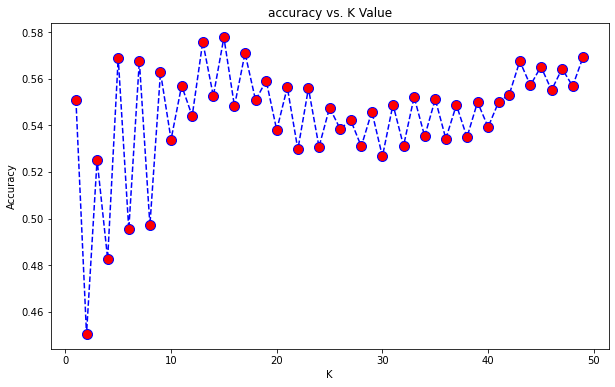

In [66]:
plt.figure(figsize=(10,6))
plt.plot(range(1,50),acc,color = 'blue',linestyle='dashed', 
         marker='o',markerfacecolor='red', markersize=10)
plt.title('accuracy vs. K Value')
plt.xlabel('K')
plt.ylabel('Accuracy')
print("Maximum accuracy:-",max(acc),"at K =",acc.index(max(acc)))

In [86]:
knn_tfidf_score=accuracy_score(y_test,y_pred_NN)
print("knn_tfidf_score :",knn_tfidf_score)

knn_tfidf_score : 0.5525807762649868


In [88]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
knn_tfidf_report=classification_report(y_test,y_pred_NN,target_names=['Positive','Negative'])
print(knn_tfidf_report)

              precision    recall  f1-score   support

    Positive       0.32      0.72      0.44      4838
    Negative       0.85      0.50      0.63     14846

    accuracy                           0.55     19684
   macro avg       0.58      0.61      0.53     19684
weighted avg       0.72      0.55      0.58     19684



In [89]:
knn_cm_tfidf=confusion_matrix(y_test,y_pred_NN,labels=[1,0])
print(knn_cm_tfidf)

[[7374 7472]
 [1335 3503]]


In [73]:
from sklearn.linear_model import LogisticRegression,SGDClassifier
lr=LogisticRegression(penalty='l2',max_iter=500,C=1,random_state=42)

In [75]:
lr_tfidf=lr.fit(X_train_tf,y_train)
print(lr_tfidf)

LogisticRegression(C=1, max_iter=500, random_state=42)


In [78]:
lr_tfidf_predict=lr.predict(X_test_tf)
print(lr_tfidf_predict)

[0 0 1 ... 1 1 1]


In [79]:
lr_tfidf_score=accuracy_score(y_test,lr_tfidf_predict)
print("lr_tfidf_score :",lr_tfidf_score)

lr_tfidf_score : 0.7871367608209714


In [81]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
lr_tfidf_report=classification_report(y_test,lr_tfidf_predict,target_names=['Positive','Negative'])
print(lr_tfidf_report)

              precision    recall  f1-score   support

    Positive       0.56      0.63      0.59      4838
    Negative       0.87      0.84      0.86     14846

    accuracy                           0.79     19684
   macro avg       0.72      0.73      0.72     19684
weighted avg       0.80      0.79      0.79     19684



In [82]:
cm_tfidf=confusion_matrix(y_test,lr_tfidf_predict,labels=[1,0])
print(cm_tfidf)

[[12454  2392]
 [ 1798  3040]]
